<a href="https://colab.research.google.com/github/crymsonashes/ASL-recognition-using-Yolov5---Sem-4-Project/blob/main/project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# setup for yolov5

!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt  # install dependencies

import torch
from IPython.display import Image, clear_output  # to display images

clear_output()
print(f"Setup complete. Using torch {torch.__version__} {torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'}")

Setup complete. Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


In [ ]:
# webcam requirements

import base64
import html
import io
import time

from IPython.display import display, Javascript
from google.colab.output import eval_js
import numpy as np
from PIL import Image
import cv2

In [ ]:
# adding the asl dataset from roboflow

%cd /content
!curl -L "https://public.roboflow.com/ds/19LR2g1wsr?key=HbhvpbwAqJ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1440      0 --:--:-- --:--:-- --:--:--  1438
100 22.3M  100 22.3M    0     0  16.0M      0  0:00:01  0:00:01 --:--:-- 16.0M
Archive:  roboflow.zip
replace test/images/G7_jpg.rf.04faf434dd590a7bd02818b2b57a704f.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
# elements included in dataset
# has a list of each letter that has corresponding images in dataset
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 26
names: ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']

model train ref - https://www.youtube.com/watch?v=MdF6x6ZmLAY

**Parameter setup**

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))


In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:
!unzip /content/yolov5s_results.zip

Archive:  /content/yolov5s_results.zip
   creating: content/yolov5/runs/train/yolov5s_results/
  inflating: content/yolov5/runs/train/yolov5s_results/test_batch2_labels.jpg  
  inflating: content/yolov5/runs/train/yolov5s_results/labels_correlogram.jpg  
  inflating: content/yolov5/runs/train/yolov5s_results/opt.yaml  
  inflating: content/yolov5/runs/train/yolov5s_results/results.txt  
  inflating: content/yolov5/runs/train/yolov5s_results/test_batch1_labels.jpg  
  inflating: content/yolov5/runs/train/yolov5s_results/train_batch1.jpg  
  inflating: content/yolov5/runs/train/yolov5s_results/test_batch2_pred.jpg  
  inflating: content/yolov5/runs/train/yolov5s_results/F1_curve.png  
  inflating: content/yolov5/runs/train/yolov5s_results/P_curve.png  
  inflating: content/yolov5/runs/train/yolov5s_results/confusion_matrix.png  
  inflating: content/yolov5/runs/train/yolov5s_results/results.png  
  inflating: content/yolov5/runs/train/yolov5s_results/train_batch2.jpg  
  inflating: conte

**Train**

In [ ]:
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 300 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v4.0-176-g2a28ef3 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=16, bbox_interval=-1, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../data.yaml', device='', entity=None, epochs=300, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=16, upload_dataset=False, weights='', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-04-01 07:05:56.059626: I tensorflow/stream_executor/platf

In [ ]:
# downloading training results

!zip -r /content/yolov5s_results.zip /content/yolov5/runs/train/yolov5s_results

  adding: content/yolov5/runs/train/yolov5s_results/ (stored 0%)
  adding: content/yolov5/runs/train/yolov5s_results/test_batch2_labels.jpg (deflated 10%)
  adding: content/yolov5/runs/train/yolov5s_results/labels_correlogram.jpg (deflated 29%)
  adding: content/yolov5/runs/train/yolov5s_results/opt.yaml (deflated 48%)
  adding: content/yolov5/runs/train/yolov5s_results/results.txt (deflated 75%)
  adding: content/yolov5/runs/train/yolov5s_results/test_batch1_labels.jpg (deflated 9%)
  adding: content/yolov5/runs/train/yolov5s_results/train_batch1.jpg (deflated 2%)
  adding: content/yolov5/runs/train/yolov5s_results/test_batch2_pred.jpg (deflated 10%)
  adding: content/yolov5/runs/train/yolov5s_results/F1_curve.png (deflated 9%)
  adding: content/yolov5/runs/train/yolov5s_results/P_curve.png (deflated 10%)
  adding: content/yolov5/runs/train/yolov5s_results/confusion_matrix.png (deflated 15%)
  adding: content/yolov5/runs/train/yolov5s_results/results.png (deflated 9%)
  adding: conten

In [ ]:
# graph for performance
%reload_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', nosave=False, project='runs/detect', save_conf=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['runs/train/yolov5s_results/weights/best.pt'])
YOLOv5 🚀 v4.0-184-g9ccfa85 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 232 layers, 7313943 parameters, 0 gradients, 17.0 GFLOPS
Traceback (most recent call last):
  File "detect.py", line 178, in <module>
    detect()
  File "detect.py", line 53, in detect
    dataset = LoadImages(source, img_size=imgsz, stride=stride)
  File "/content/yolov5/utils/datasets.py", line 132, in __init__
    raise Exception(f'ERROR: {p} does not exist')
Exception: ERROR: /content/yolov5/../test/images does not exist


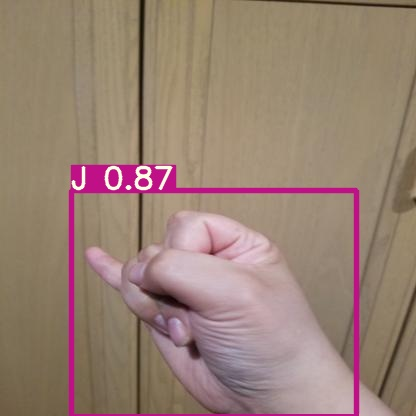

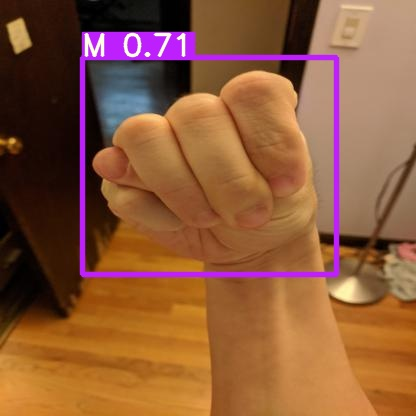

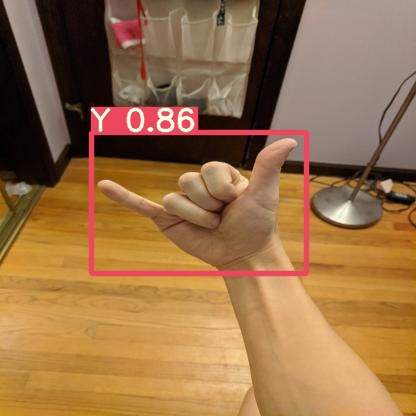

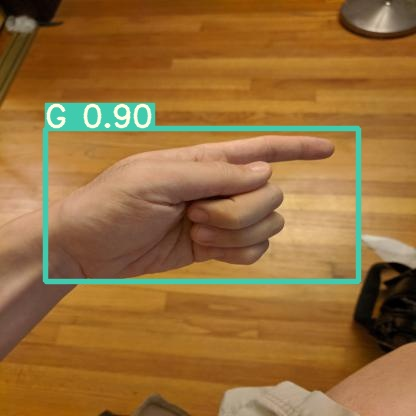

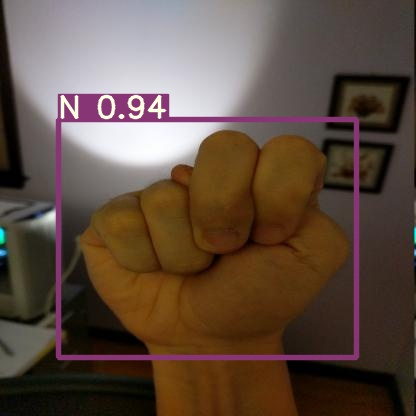

...

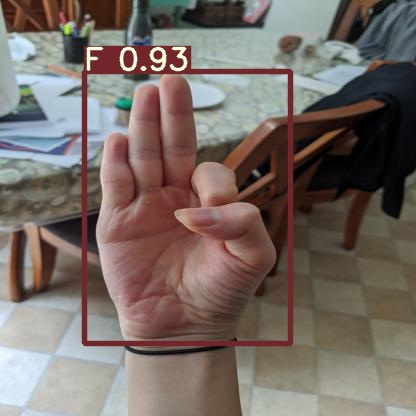

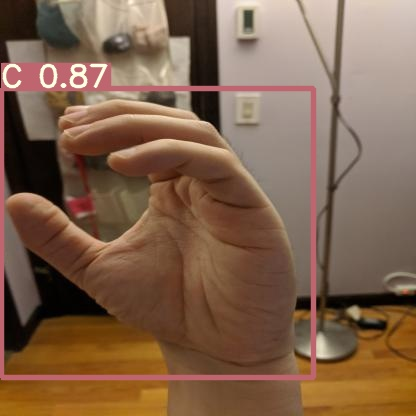

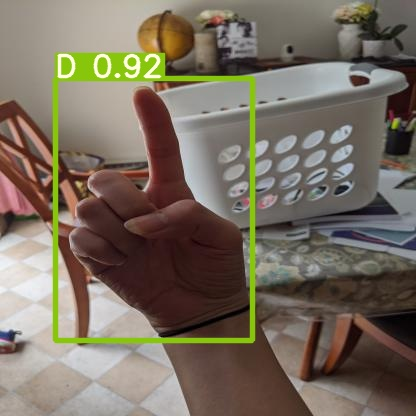

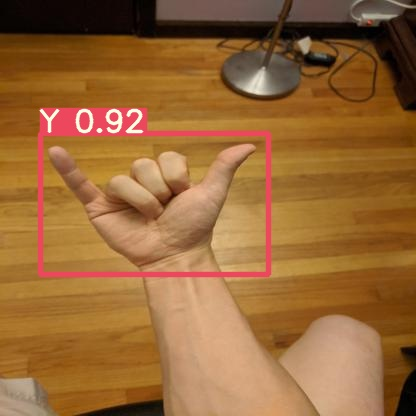

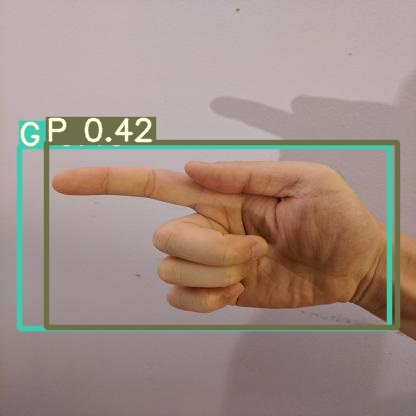

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
# upload the vid before running this
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../asl_vid.mp4

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', nosave=False, project='runs/detect', save_conf=False, save_txt=False, source='../asl_vid.mp4', update=False, view_img=False, weights=['runs/train/yolov5s_results/weights/best.pt'])
YOLOv5 🚀 v4.0-184-g9ccfa85 torch 1.8.1+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 232 layers, 7313943 parameters, 0 gradients, 17.0 GFLOPS
video 1/1 (1/1284) /content/yolov5/../asl_vid.mp4: 288x416 1 M, Done. (0.072s)
video 1/1 (2/1284) /content/yolov5/../asl_vid.mp4: 288x416 1 M, Done. (0.011s)
video 1/1 (3/1284) /content/yolov5/../asl_vid.mp4: 288x416 1 M, Done. (0.010s)
video 1/1 (4/1284) /content/yolov5/../asl_vid.mp4: 288x416 1 M, Done. (0.010s)
video 1/1 (5/1284) /content/yolov5/../asl_vid.mp4: 288x416 1 M, Done. (0.010s)
video 1/1 (6/1284) /content/yolov5/../asl_vid.mp4: 288x416 1 M, Done. (0.010s)
video 

Webcam Testing stuff

In [ ]:
# refer https://colab.research.google.com/drive/1QnC7lV7oVFk5OZCm75fqbLAfD9qBy9bw?usp=sharing#scrollTo=09b_0FAnUa9y

# could use this to figure real time https://github.com/theAIGuysCode/colab-webcam

# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

In [ ]:
# refer https://colab.research.google.com/notebooks/snippets/advanced_outputs.ipynb#scrollTo=buJCl90WhNfq for camera code snippet

from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  # get photo data
  data = eval_js('takePhoto({})'.format(quality))
  # get OpenCV format image
  #img = js_to_image(data) 
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  # save image
  #cv2.imwrite(filename, img)
  return filename

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
# still doesn't work
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source /content/yolov5/photo.jpg